In [62]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap


import seaborn as sns
import warnings
import calendar

warnings.filterwarnings("ignore")

In [63]:
accidentes= pd.read_csv('./DATA/accidentes.csv')


In [64]:
accidentes

,ID,VICTIMAS,FECHA,ANIO,MES,DIA,HORA,MEDIO,COMUNA,X,Y,PARTICIPANTES,ACUSADO,ROL,DAMNIFICADO,SEXO,EDAD,OBITO
0,2016-0001,1,2016-01-01,2016,1,1,04:00:00,AVENIDA,8,-58.475340,-34.687570,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,19,1
1,2016-0002,1,2016-01-02,2016,1,2,01:15:00,AUTOPISTA,9,-58.508775,-34.669777,AUTO-PASAJEROS,PASAJEROS,CONDUCTOR,AUTO,MASCULINO,70,1
2,2016-0003,1,2016-01-03,2016,1,3,07:00:00,AVENIDA,1,-58.390403,-34.631894,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,30,1
3,2016-0004,1,2016-01-10,2016,1,10,00:00:00,AVENIDA,8,-58.465039,-34.680930,MOTO-SD,DESCONOCIDO,CONDUCTOR,MOTO,MASCULINO,18,1
4,2016-0005,1,2016-01-21,2016,1,21,05:20:00,AVENIDA,1,-58.387183,-34.622466,MOTO-PASAJEROS,PASAJEROS,CONDUCTOR,MOTO,MASCULINO,29,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26556,LC-2021-0652849,1,2021-12-31,2021,12,31,19:30:00,AVENIDA,9,-58.513477,-34.659714,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,29,0
26557,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,28,0
26558,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,52,0
26559,LC-2021-0652907,1,2021-12-31,2021,12,31,20:00:00,DESCONOCIDO,1,-58.382894,-34.583083,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,23,0


In [65]:
accidentes_obitos= accidentes[accidentes['OBITO'] == 1].copy()
accidentes_lesiones= accidentes[accidentes['OBITO'] == 0].copy()

### VICTIMAS POR COMUNA

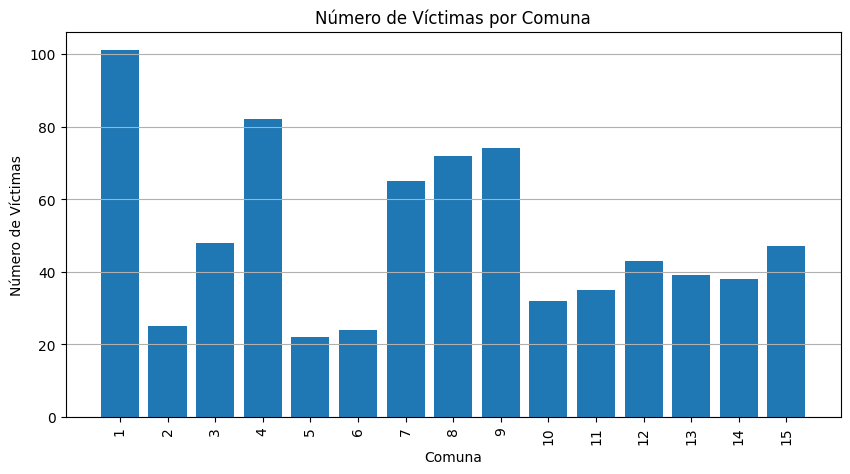

In [127]:

# Agrupa por comuna y suma las víctimas
victimas_por_comuna = accidentes_obitos.groupby('COMUNA')['VICTIMAS'].sum().reset_index()

# Filtrar comunas con víctimas
victimas_por_comuna = victimas_por_comuna[victimas_por_comuna['VICTIMAS'] > 0]

# Ajustar los índices para que coincidan con la posición en el eje x
victimas_por_comuna = victimas_por_comuna.reset_index(drop=True)

# Crea la gráfica de barras
plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_por_comuna.index, victimas_por_comuna['VICTIMAS'])
plt.title('Número de Víctimas por Comuna')
plt.xlabel('Comuna')
plt.ylabel('Número de Víctimas')

# Ajustar las etiquetas para mostrar una de cada una
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_por_comuna.index)), victimas_por_comuna['COMUNA'], rotation=90)

plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### ANUAL

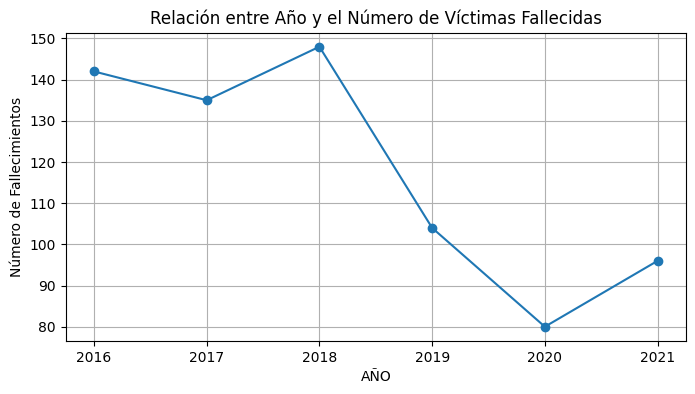

In [66]:
victimas_anual = accidentes_obitos.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Fallecidas')
plt.xlabel('AÑO')
plt.ylabel('Número de Fallecimientos')
plt.grid(True)

plt.show()

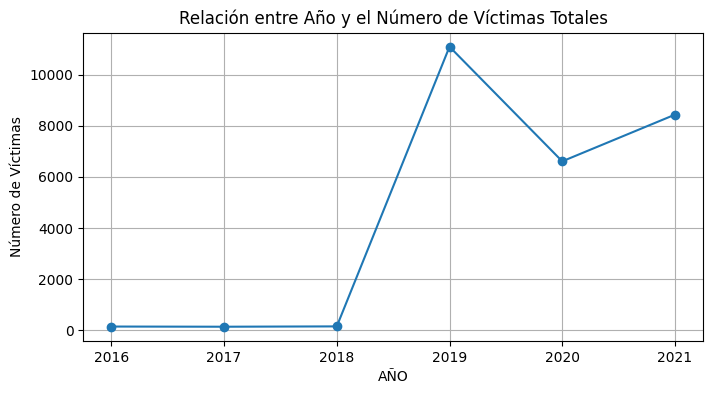

In [67]:
victimas_anual = accidentes.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Totales')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas')
plt.grid(True)

plt.show()

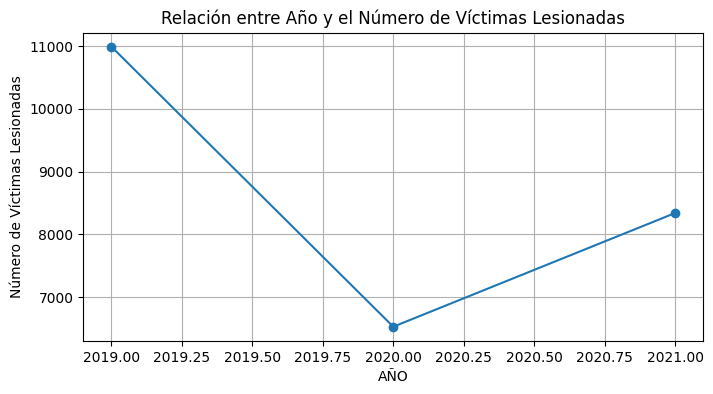

In [68]:
victimas_anual = accidentes_lesiones.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Lesionadas')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas Lesionadas')
plt.grid(True)

plt.show()

#### MES

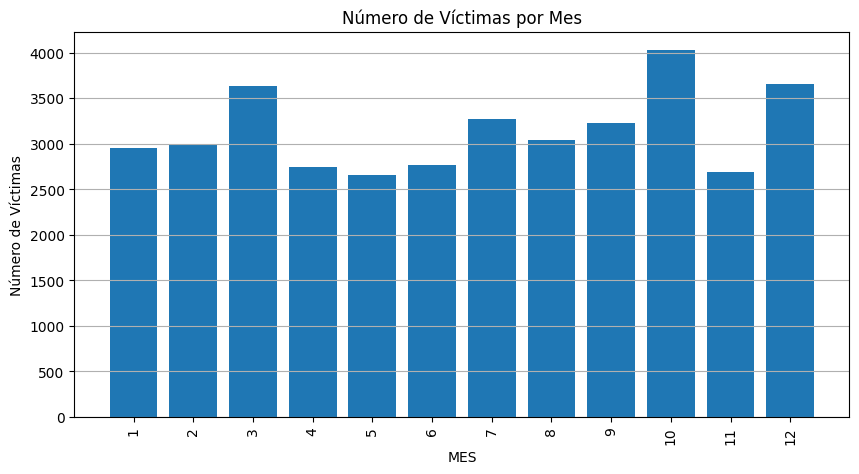

In [141]:
# Agrupa por comuna y suma las víctimas
victimas_mes = accidentes.groupby('MES')['VICTIMAS'].sum().reset_index()

# Filtrar comunas con víctimas
victimas_mes = victimas_mes[victimas_mes['VICTIMAS'] > 0]

# Ajustar los índices para que coincidan con la posición en el eje x
victimas_mes = victimas_mes.reset_index(drop=True)

# Crea la gráfica de barras
plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_mes.index, victimas_mes['VICTIMAS'])
plt.title('Número de Víctimas por Mes')
plt.xlabel('MES')
plt.ylabel('Número de Víctimas')

# Ajustar las etiquetas para mostrar una de cada una
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_mes.index)), victimas_mes['MES'], rotation=90)

plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### HORA

In [144]:
victimas_hora = ['HORA', 'VICTIMAS', 'OBITO']
accidentes_hora = accidentes[victimas_hora]

In [152]:
accidentes_hora = accidentes_hora[accidentes_hora['HORA'] != 'SD']

accidentes_hora['HORA'] = accidentes_hora['HORA'].str.slice(0, 2).astype('Int64')


In [153]:
accidentes_hora['HORA'].unique()

<IntegerArray>
[ 4,  1,  7,  0,  5, 18, 19, 15, 11, 22, 16,  9, 23,  6, 10, 17, 12,  8, 21,
 20, 14,  3,  2, 13]
Length: 24, dtype: Int64

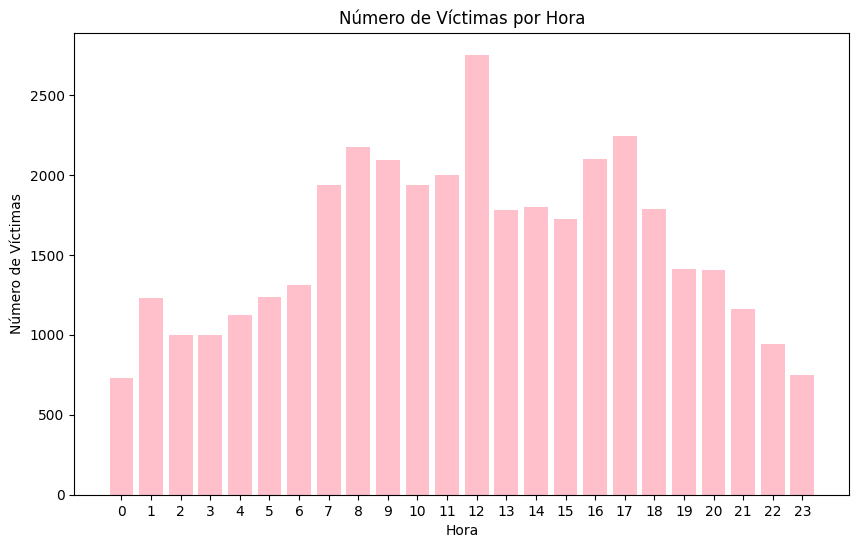

In [157]:
# Agrupar por hora y sumar las víctimas
victimas_por_hora = accidentes_hora.groupby('HORA')['VICTIMAS'].sum().reset_index()

# Reindexar para asegurarse de tener todas las horas
horas_completas = pd.DataFrame({'HORA': range(0, 24)}).set_index('HORA')
victimas_por_hora = horas_completas.merge(victimas_por_hora, how='left', left_index=True, right_on='HORA').fillna(0)

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(victimas_por_hora['HORA'], victimas_por_hora['VICTIMAS'], color='pink')
plt.title('Número de Víctimas por Hora')
plt.xlabel('Hora')
plt.ylabel('Número de Víctimas')
plt.xticks(range(24))  # Mostrar todas las horas en el eje X
plt.show()

## ROL

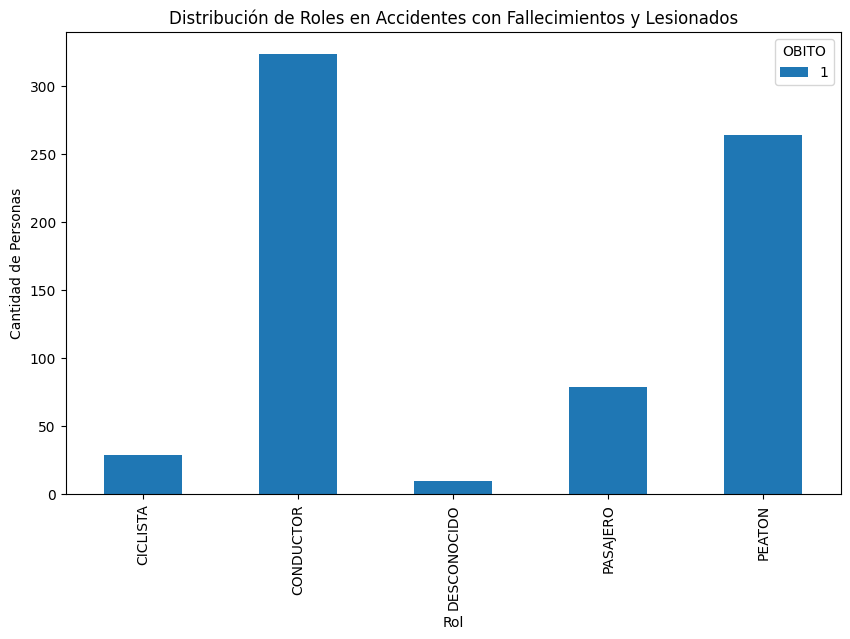

In [136]:
# Agrupar por rol y contar la cantidad de fallecimientos y lesionados
conteo_roles = accidentes_obitos.groupby(['ROL', 'OBITO']).size().unstack(fill_value=0)

# Crear el gráfico de barras
conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles en Accidentes con Fallecimientos y Lesionados')
plt.xlabel('Rol')
plt.ylabel('Cantidad de Personas')
plt.show()

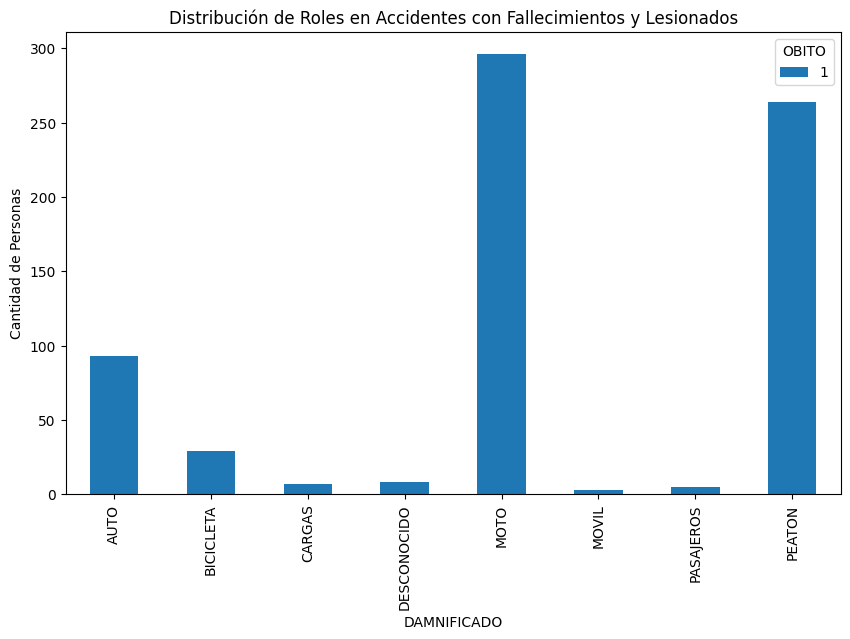

In [135]:
# Agrupar por rol y contar la cantidad de fallecimientos y lesionados
conteo_roles = accidentes_obitos.groupby(['DAMNIFICADO', 'OBITO']).size().unstack(fill_value=0)

# Crear el gráfico de barras
conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles en Accidentes con Fallecimientos y Lesionados')
plt.xlabel('DAMNIFICADO')
plt.ylabel('Cantidad de Personas')
plt.show()

### VICTIMAS POR GÉNERO

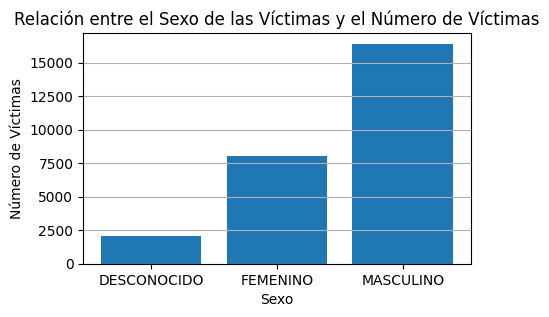

In [92]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo = accidentes.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo['SEXO'], victimas_por_sexo['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()


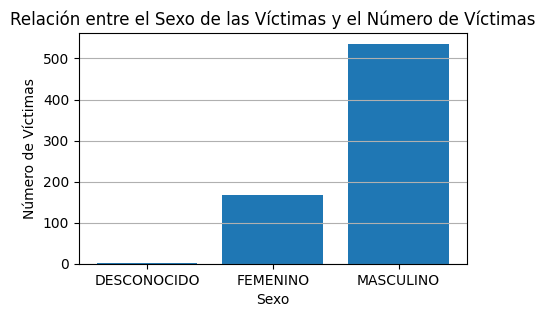

In [93]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo = accidentes_obitos.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo['SEXO'], victimas_por_sexo['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

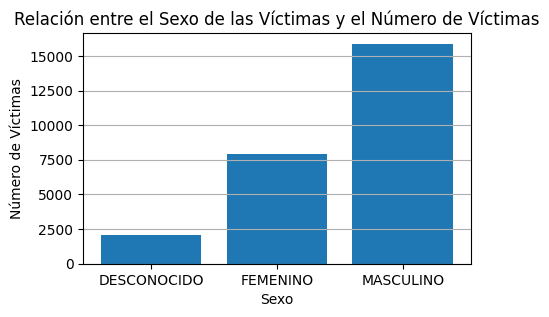

In [94]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo = accidentes_lesiones.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo['SEXO'], victimas_por_sexo['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### VICTIMAS POR EDAD

In [98]:
columnasres = ['EDAD', 'VICTIMAS', 'OBITO']
accidentes_edad = accidentes[columnasres]

In [99]:
accidentes_edad

,EDAD,VICTIMAS,OBITO
0,19,1,1
1,70,1,1
2,30,1,1
3,18,1,1
4,29,1,1
...,...,...,...
26556,29,1,0
26557,28,2,0
26558,52,2,0
26559,23,1,0


In [105]:
# Crear la columna "RANGO" basada en las edades
bins = [0, 12, 19, 40, 65, float('inf')]
labels = ['NIÑXS', 'ADOLESCENTES', 'JOVENES', 'MAYORES', 'ANCIANOS']

accidentes_edad['RANGO'] = pd.cut(accidentes_edad['EDAD'], bins=bins, labels=labels, right=False)


In [106]:
accidentes_edad

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
26556,29,1,0,JOVENES
26557,28,2,0,JOVENES
26558,52,2,0,MAYORES
26559,23,1,0,JOVENES


In [112]:
apariciones_por_rango = accidentes_edad['RANGO'].value_counts().sort_index()
apariciones_por_rango


RANGO
NIÑXS            4576
ADOLESCENTES      568
JOVENES         12919
MAYORES          6969
ANCIANOS         1529
Name: count, dtype: int64

In [107]:
# Crear DataFrame para OBITO igual a 1 (accidentes mortales)
accidentes_edad_obito = accidentes_edad[accidentes_edad['OBITO'] == 1]

# Crear DataFrame para OBITO igual a 0 (accidentes con lesiones)
accidentes_edad_lesiones = accidentes_edad[accidentes_edad['OBITO'] == 0]

In [108]:
accidentes_edad_obito

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
700,43,1,1,MAYORES
701,27,1,1,JOVENES
702,60,1,1,MAYORES
703,53,1,1,MAYORES


In [115]:
obito_por_rango = accidentes_edad_obito['RANGO'].value_counts().sort_index()
obito_por_rango


RANGO
NIÑXS            57
ADOLESCENTES     20
JOVENES         332
MAYORES         184
ANCIANOS        112
Name: count, dtype: int64

In [109]:
accidentes_edad_lesiones

,EDAD,VICTIMAS,OBITO,RANGO
704,0,1,0,NIÑXS
705,57,1,0,MAYORES
706,0,1,0,NIÑXS
707,0,1,0,NIÑXS
708,45,4,0,MAYORES
...,...,...,...,...
26556,29,1,0,JOVENES
26557,28,2,0,JOVENES
26558,52,2,0,MAYORES
26559,23,1,0,JOVENES


In [116]:
lesiones_por_rango = accidentes_edad_lesiones['RANGO'].value_counts().sort_index()
lesiones_por_rango

RANGO
NIÑXS            4519
ADOLESCENTES      548
JOVENES         12587
MAYORES          6785
ANCIANOS         1417
Name: count, dtype: int64

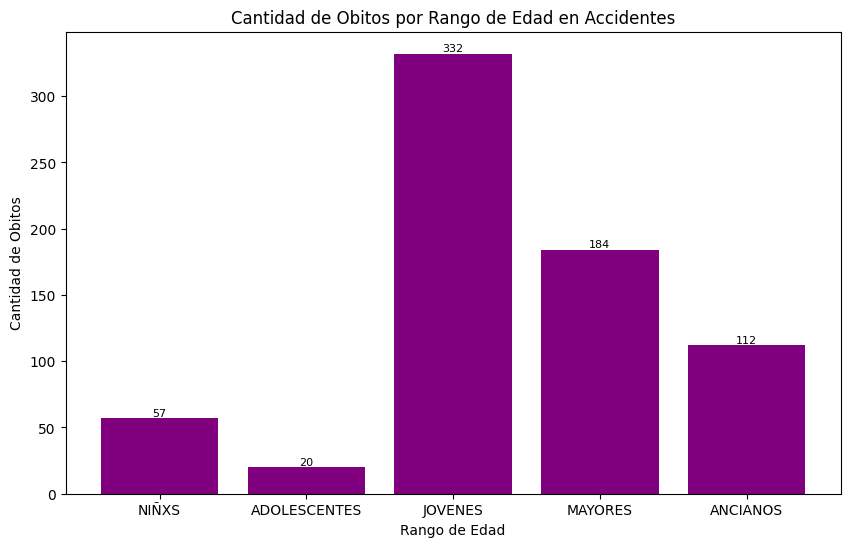

In [118]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(obito_por_rango.index, obito_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Obitos')
plt.title('Cantidad de Obitos por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

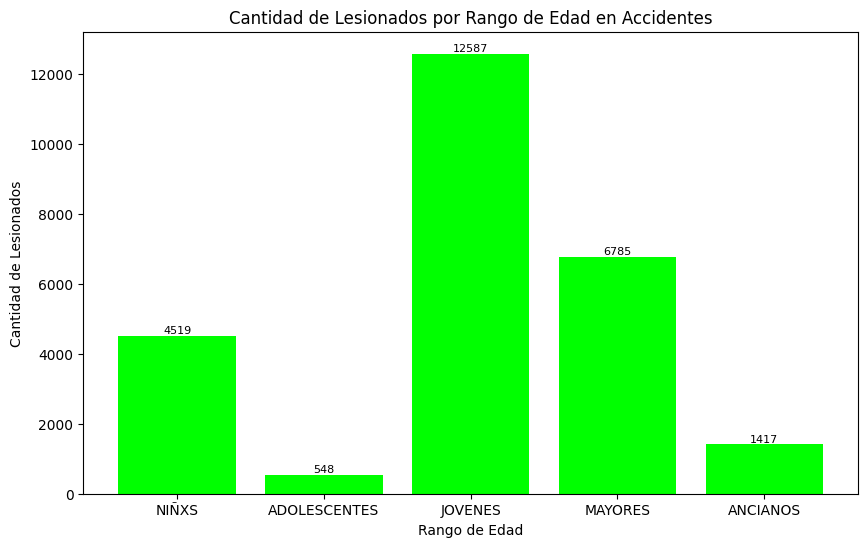

In [117]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(lesiones_por_rango.index, lesiones_por_rango, color='lime')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Lesionados')
plt.title('Cantidad de Lesionados por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

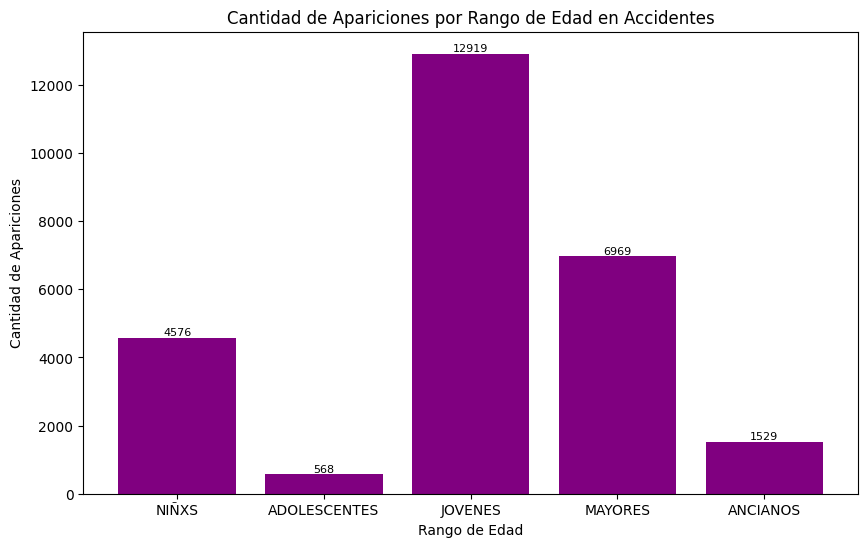

In [114]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(apariciones_por_rango.index, apariciones_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Apariciones')
plt.title('Cantidad de Apariciones por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

### MEDIO

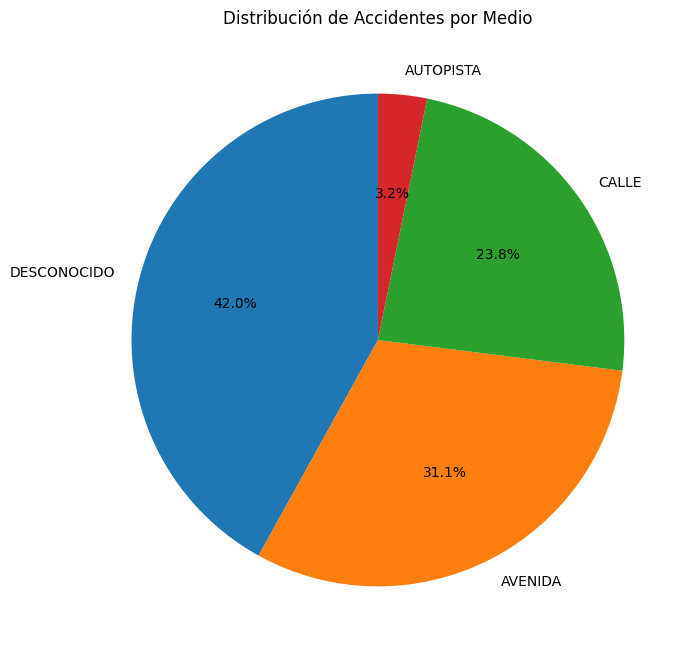

In [128]:
conteo_medios = accidentes['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios, labels=conteo_medios.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Accidentes por Medio')
plt.show()

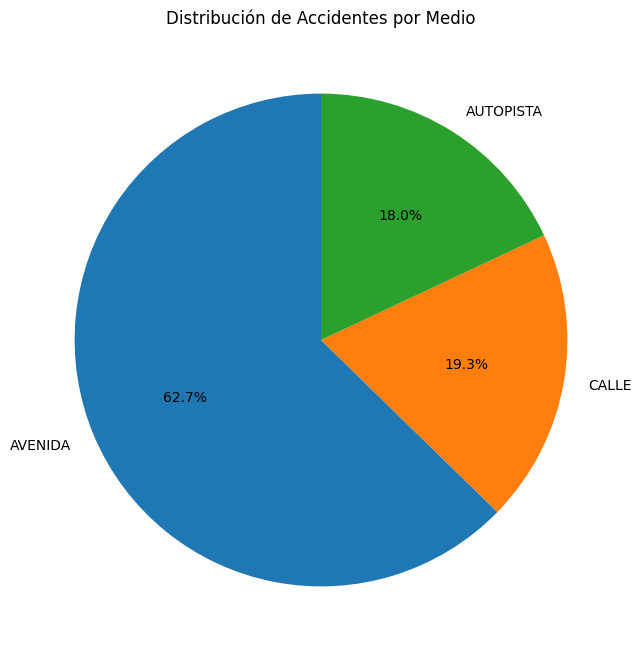

In [129]:
conteo_medios = accidentes_obitos['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios, labels=conteo_medios.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Accidentes por Medio')
plt.show()

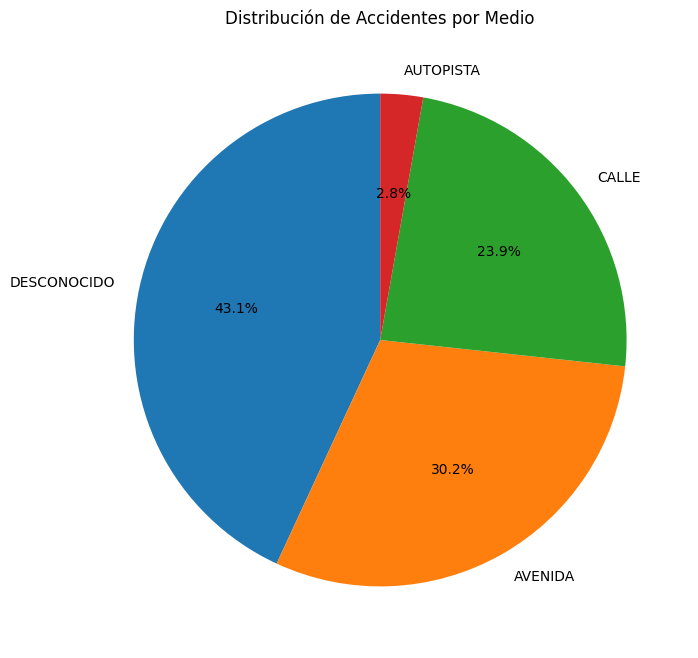

In [130]:
conteo_medios = accidentes_lesiones['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios, labels=conteo_medios.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Accidentes por Medio')
plt.show()

### ROL

## KPI's

In [69]:
kpi1 = accidentes.loc[accidentes['OBITO'] == 1, ['ANIO', 'MES']]


In [70]:
kpi1

,ANIO,MES
0,2016,1
1,2016,1
2,2016,1
3,2016,1
4,2016,1
...,...,...
700,2021,12
701,2021,12
702,2021,12
703,2021,11


In [71]:

# Filtra los datos para el año 2021
siniestros_2021 = kpi1[kpi1['ANIO'] == 2021]

# Calcula el porcentaje anual de homicidios
porcentaje_anual = (siniestros_2021.shape[0] / kpi1.shape[0]) * 100

# Filtra los datos para el Semestre 1 y Semestre 2
semestre_1 = siniestros_2021[siniestros_2021['MES'] <= 6]
semestre_2 = siniestros_2021[siniestros_2021['MES'] > 6]

# Calcula el porcentaje de homicidios por semestre en relación con el total del año
porcentaje_semestre_1 = (semestre_1.shape[0] / siniestros_2021.shape[0]) * 100
porcentaje_semestre_2 = (semestre_2.shape[0] / siniestros_2021.shape[0]) * 100


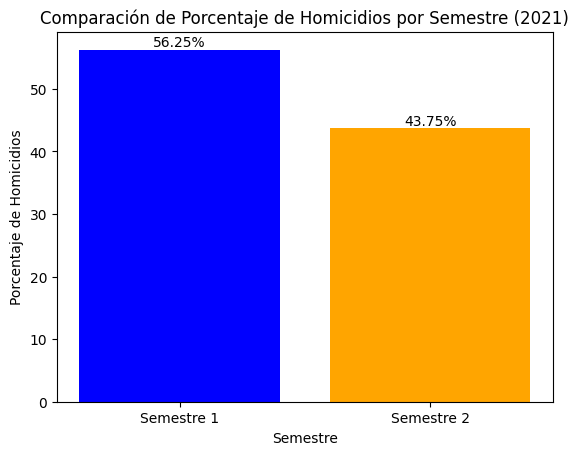

In [72]:
# Visualizar el porcentaje de homicidios por semestre
fig, ax = plt.subplots()
bars = ax.bar(['Semestre 1', 'Semestre 2'], [porcentaje_semestre_1, porcentaje_semestre_2], color=['blue', 'orange'])

plt.xlabel('Semestre')
plt.ylabel('Porcentaje de Homicidios')
plt.title('Comparación de Porcentaje de Homicidios por Semestre (2021)')

# Agregar etiquetas con los valores porcentuales sobre las barras
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.2f}%', ha='center', va='bottom')

plt.show()

In [73]:
kpi2 = accidentes.loc[accidentes['OBITO'] == 1, ['ANIO', 'DAMNIFICADO']]


In [74]:
kpi2 = kpi2.loc[kpi2['DAMNIFICADO'] == 'MOTO', ['ANIO', 'DAMNIFICADO']]


In [75]:
kpi2['DAMNIFICADO'].unique()

array(['MOTO'], dtype=object)

In [76]:
kpi2

,ANIO,DAMNIFICADO
0,2016,MOTO
2,2016,MOTO
3,2016,MOTO
4,2016,MOTO
5,2016,MOTO
...,...,...
697,2021,MOTO
699,2021,MOTO
700,2021,MOTO
701,2021,MOTO


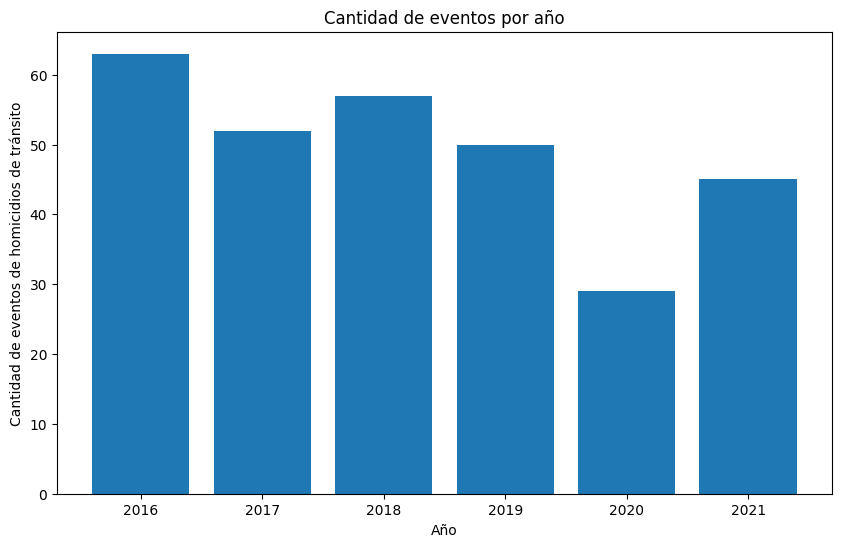

In [77]:
# Contar la cantidad de eventos por año
kpi2_agrupado = kpi2['ANIO'].value_counts().sort_index()

# Graficar
plt.figure(figsize=(10, 6))
plt.bar(kpi2_agrupado.index, kpi2_agrupado)
plt.xlabel('Año')
plt.ylabel('Cantidad de eventos de homicidios de tránsito')
plt.title('Cantidad de eventos por año')
plt.show()

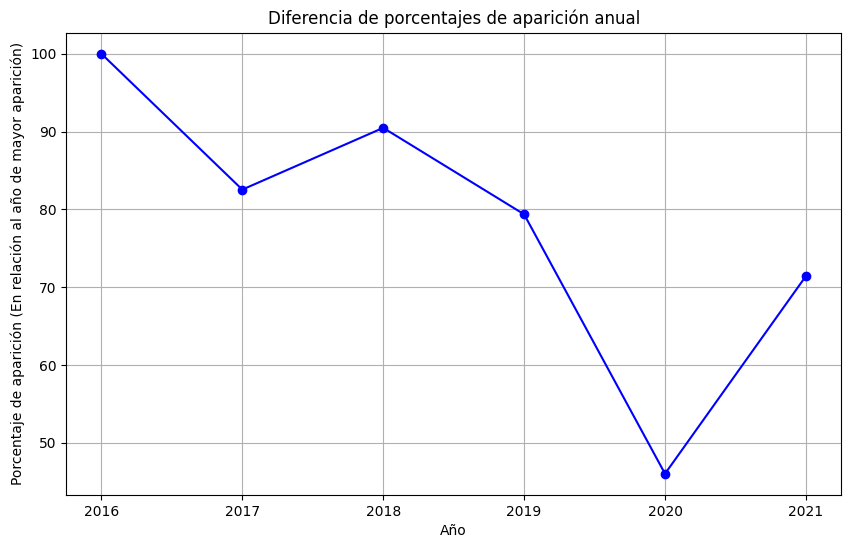

In [78]:
# Calcular el porcentaje de aparición anual
porcentaje_aparicion = kpi2['ANIO'].value_counts(normalize=True).sort_index() * 100

# Obtener el año de mayor aparición
año_mayor_aparicion = porcentaje_aparicion.idxmax()

# Calcular el porcentaje en relación al año de mayor aparición
porcentaje_aparicion_relativo = porcentaje_aparicion / porcentaje_aparicion[año_mayor_aparicion] * 100

# Crear DataFrame para unplot
df_unplot = pd.DataFrame({'Año': porcentaje_aparicion_relativo.index, 'Porcentaje': porcentaje_aparicion_relativo.values})

# Graficar unplot
plt.figure(figsize=(10, 6))
plt.plot(df_unplot['Año'], df_unplot['Porcentaje'], marker='o', linestyle='-', color='blue')
plt.xlabel('Año')
plt.ylabel('Porcentaje de aparición (En relación al año de mayor aparición)')
plt.title('Diferencia de porcentajes de aparición anual')
plt.grid(True)
plt.show()

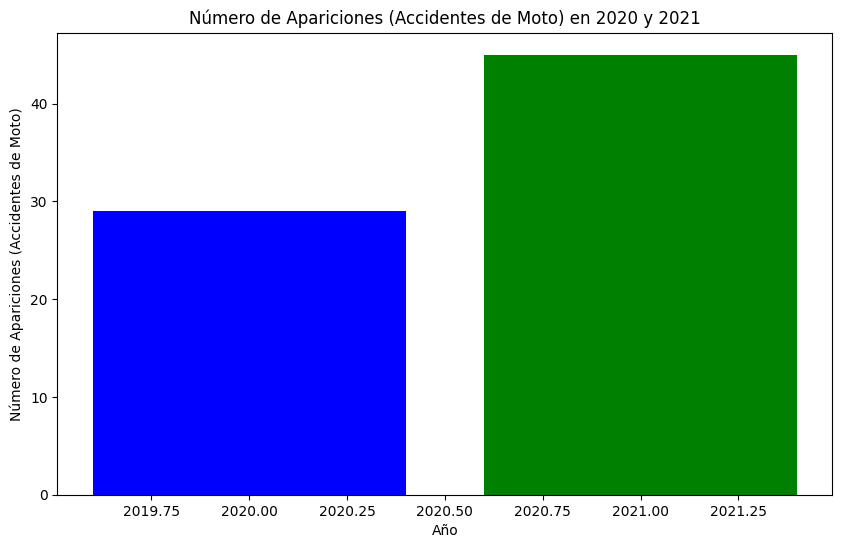

In [79]:

# Filtrar los datos para 2020 y 2021
df_filt = kpi2[kpi2['ANIO'].isin([2020, 2021])]

# Contar la cantidad de apariciones por año
apariciones_por_anio = df_filt['ANIO'].value_counts().sort_index()

# Graficar barplot
plt.figure(figsize=(10, 6))
plt.bar(apariciones_por_anio.index, apariciones_por_anio, color=['blue', 'green'])
plt.xlabel('Año')
plt.ylabel('Número de Apariciones (Accidentes de Moto)')
plt.title('Número de Apariciones (Accidentes de Moto) en 2020 y 2021')
plt.show()

### MAPAS
#### 1. ZONAS CON MAYOR TASA DE ACCIDENTES CON OBITO
#### 2. COMPARACIÓN ENTRE ACCIDENTES CON LESIONES (AZUL) Y ACCIDENTES CON ÓBITOS (ROJO)

In [80]:
mapa = accidentes.loc[accidentes['OBITO'] == 1, ['X', 'Y']]
mapa = mapa.dropna(subset=['X', 'Y'])
print(mapa)

               X          Y
0     -58.475340 -34.687570
1     -58.508775 -34.669777
2     -58.390403 -34.631894
3     -58.465039 -34.680930
4     -58.387183 -34.622466
...          ...        ...
700   -58.467398 -34.651178
701   -58.472934 -34.619847
702   -58.470668 -34.650217
703   -58.379762 -34.586796
17239 -58.466449 -34.700942

[705 rows x 2 columns]


In [81]:
mapa = mapa.dropna(subset=['X', 'Y'])

centro_mapa = [mapa['Y'].mean(), mapa['X'].mean()]
mapa_obitos = folium.Map(location=centro_mapa, zoom_start=12)
heat_data = [[row['Y'], row['X']] for index, row in mapa.iterrows()]
HeatMap(heat_data, radius=17, cmap='inferno', gradient={.5: 'purple', .6: 'blue', 1: 'red'}).add_to(mapa_obitos)

mapa_obitos.save('mapa_obitos.html')

In [82]:
mapa_obitos

In [83]:
mapa1 = accidentes[['X', 'Y', 'OBITO']].copy()

mapa1 = mapa1.dropna(subset=['X', 'Y'])

In [84]:
mapa1

,X,Y,OBITO
0,-58.475340,-34.687570,1
1,-58.508775,-34.669777,1
2,-58.390403,-34.631894,1
3,-58.465039,-34.680930,1
4,-58.387183,-34.622466,1
...,...,...,...
26556,-58.513477,-34.659714,0
26557,-58.488327,-34.641753,0
26558,-58.488327,-34.641753,0
26559,-58.382894,-34.583083,0


In [85]:
centro_mapa = [mapa1['Y'].mean(), mapa1['X'].mean()]
mapaObitosyLesiones = folium.Map(location=centro_mapa, zoom_start=13)

for index, row in mapa1.iterrows():
    if row['OBITO'] == 1:
        radius = 10  
        color = 'red'
    else:
        radius = .8
        color = 'blue'
    folium.CircleMarker(
        location=[row['Y'], row['X']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.4,
        popup=f"Ubicación: {row['Y']}, {row['X']}\nOBITO: {row['OBITO']}"
    ).add_to(mapaObitosyLesiones)

mapaObitosyLesiones.save('mapaObitosyLesiones.html')

In [86]:
mapaObitosyLesiones